<a href="https://colab.research.google.com/github/Zardian18/Celeb-Faces-Comparision/blob/master/StyleGAN2_faces.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!curl -s https://packagecloud.io/install/repositories/github/git-lfs/script.deb.sh | bash
!apt-get install git-lfs
!git lfs install

Detected operating system as Ubuntu/jammy.
Checking for curl...
Detected curl...
Checking for gpg...
Detected gpg...
Detected apt version as 2.4.11
Running apt-get update... done.
Installing apt-transport-https... done.
Installing /etc/apt/sources.list.d/github_git-lfs.list...done.
Importing packagecloud gpg key... Packagecloud gpg key imported to /etc/apt/keyrings/github_git-lfs-archive-keyring.gpg
done.
Running apt-get update... done.

The repository is setup! You can now install packages.
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following packages will be upgraded:
  git-lfs
1 upgraded, 0 newly installed, 0 to remove and 39 not upgraded.
Need to get 7,421 kB of archives.
After this operation, 6,006 kB of additional disk space will be used.
Get:1 https://packagecloud.io/github/git-lfs/ubuntu jammy/main amd64 git-lfs amd64 3.4.1 [7,421 kB]
Fetched 7,421 kB in 0s (15.5 MB/s)
(Reading database ... 121753 files and directories c

In [ ]:
!pip install kaggle

In [3]:
from google.colab import drive
drive.mount("/content/drive")

! mkdir ~/.kaggle
!cp /content/drive/MyDrive/kaggle/kaggle.json ~/.kaggle/kaggle.json
!chmod 600 ~/.kaggle/kaggle.json

Mounted at /content/drive


In [4]:
!kaggle datasets download -d jessicali9530/celeba-dataset

 99% 1.32G/1.33G [00:11<00:00, 114MB/s]
100% 1.33G/1.33G [00:11<00:00, 119MB/s]


In [ ]:
!unzip celeba-dataset.zip

In [ ]:
!pip install stylegan2_pytorch

In [7]:
!stylegan2_pytorch --help

INFO: Showing help with the command 'stylegan2_pytorch -- --help'.

NAME
    stylegan2_pytorch

SYNOPSIS
    stylegan2_pytorch <flags>

FLAGS
    --data=DATA
        Default: './data'
    --results_dir=RESULTS_DIR
        Default: './results'
    --models_dir=MODELS_DIR
        Default: './models'
    --name=NAME
        Default: 'default'
    --new=NEW
        Default: False
    --load_from=LOAD_FROM
        Default: -1
    --image_size=IMAGE_SIZE
        Default: 128
    --network_capacity=NETWORK_CAPACITY
        Default: 16
    --fmap_max=FMAP_MAX
        Default: 512
    --transparent=TRANSPARENT
        Default: False
    -b, --batch_size=BATCH_SIZE
        Default: 5
    --gradient_accumulate_every=GRADIENT_ACCUMULATE_EVERY
        Default: 6
    --num_train_steps=NUM_TRAIN_STEPS
        Default: 150000
    --learning_rate=LEARNING_RATE
        Default: 0.0002
    --lr_mlp=LR_MLP
        Default: 0.1
    --ttur_mult=TTUR_MULT
        Default: 1.5
    --rel_disc_loss=REL_DISC_LOS

In [8]:
!stylegan2_pytorch --data /content/img_align_celeba/img_align_celeba --image-size 64 --batch-size 16 --save-every 250 --evaluate-every 250 --num-train-steps 3000

default</content/img_align_celeba/img_align_celeba>:   2% 50/3000 [01:25<1:24:23,  1.72s/it]G: 5.45 | D: 2.73 | GP: 1.18
default</content/img_align_celeba/img_align_celeba>:   3% 100/3000 [02:45<1:20:11,  1.66s/it]G: 6.17 | D: 2.41 | GP: 1.37
default</content/img_align_celeba/img_align_celeba>:   5% 150/3000 [04:08<1:18:41,  1.66s/it]G: 1.02 | D: 0.84 | GP: 0.61
default</content/img_align_celeba/img_align_celeba>:   7% 200/3000 [05:30<1:17:00,  1.65s/it]G: 9.22 | D: 2.68 | GP: 0.35
default</content/img_align_celeba/img_align_celeba>:   8% 250/3000 [06:53<1:15:44,  1.65s/it]G: 1.79 | D: 0.32 | GP: 0.53
default</content/img_align_celeba/img_align_celeba>:  10% 300/3000 [08:15<1:14:19,  1.65s/it]G: 0.83 | D: 0.87 | GP: 0.93
default</content/img_align_celeba/img_align_celeba>:  12% 350/3000 [09:38<1:12:59,  1.65s/it]G: 1.93 | D: 0.56 | GP: 0.27
default</content/img_align_celeba/img_align_celeba>:  13% 400/3000 [10:59<1:11:26,  1.65s/it]G: 1.04 | D: 1.10 | GP: 8.68
default</content/img_alig

In [9]:
!stylegan2_pytorch --generate --num_generate=4 --num_image_tiles=8

continuing from previous epoch - 12
loading from version 1.8.9
100% 4/4 [00:03<00:00,  1.23it/s]
sample images generated at ./results/default/generated-02-24-2024_10-26-36


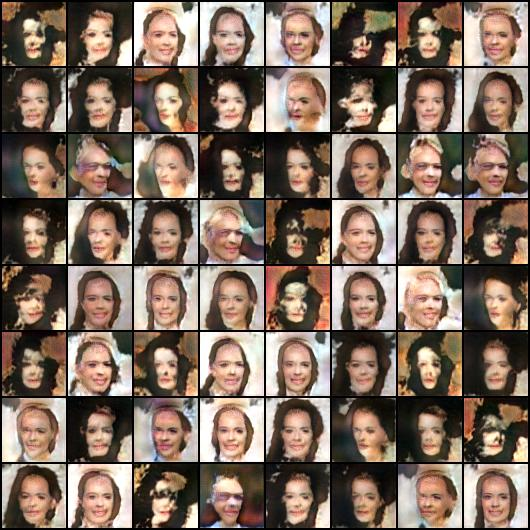

In [13]:
from IPython.display import Image, display
display(Image(filename="/content/results/default/generated-02-24-2024_10-26-36-3.jpg"))

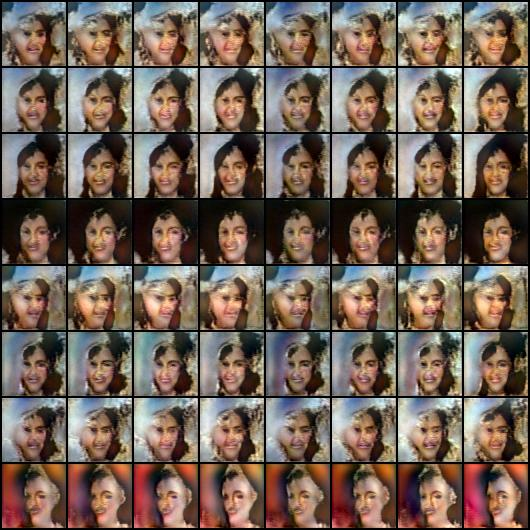

In [14]:
display(Image(filename="/content/results/default/generated-02-24-2024_10-26-36-3-mr.jpg"))

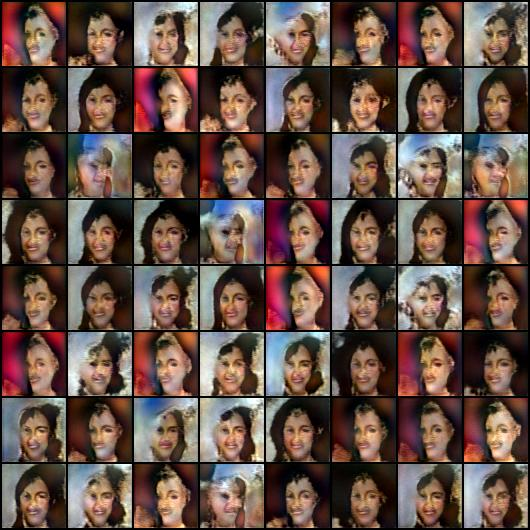

In [15]:
display(Image(filename="/content/results/default/generated-02-24-2024_10-26-36-3-ema.jpg"))

In [16]:
!stylegan2_pytorch --generate-interpolation --interpolation-num-steps 100

continuing from previous epoch - 12
loading from version 1.8.9
100% 100/100 [00:14<00:00,  6.78it/s]
interpolation generated at ./results/default/generated-02-24-2024_10-31-12


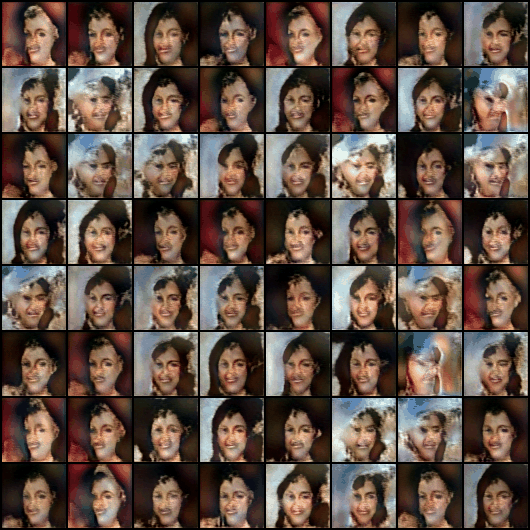

In [17]:
display(Image(filename="/content/results/default/generated-02-24-2024_10-31-12.gif"))

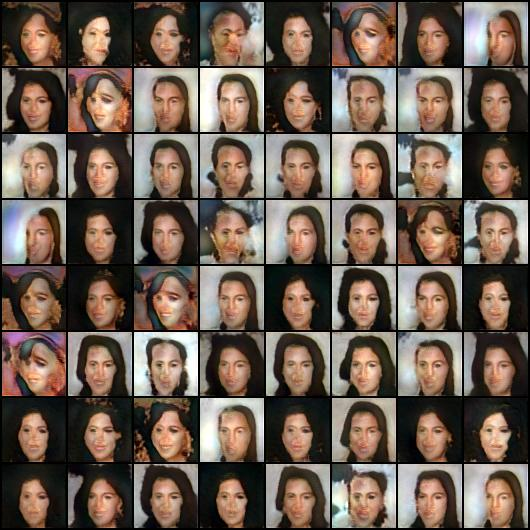

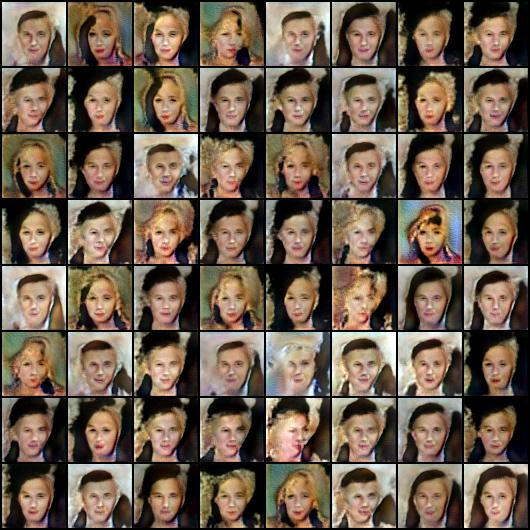

This was trained for merely 3000 steps.